# Initial Code: 03/14/25

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:04<00:00, 130MB/s]


Step 0, Loss: 316.4928894042969


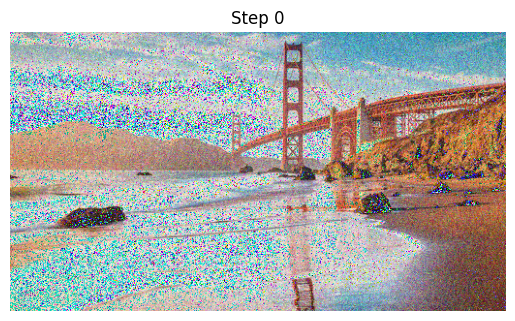

Step 50, Loss: 11.671160697937012


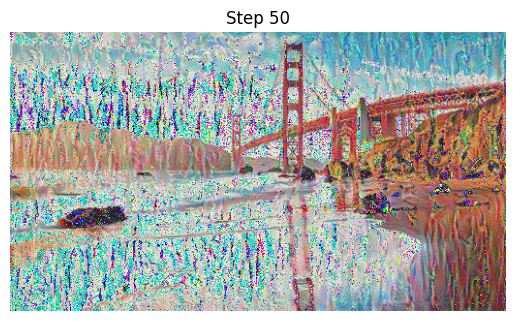

Step 100, Loss: 7.569664001464844


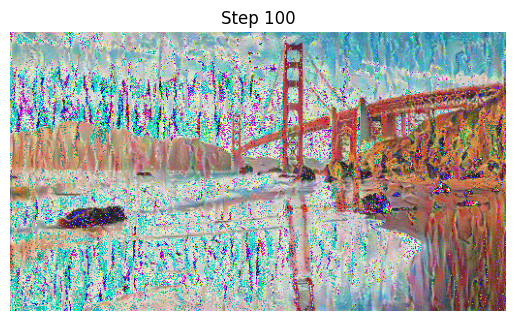

Step 150, Loss: 6.415916442871094


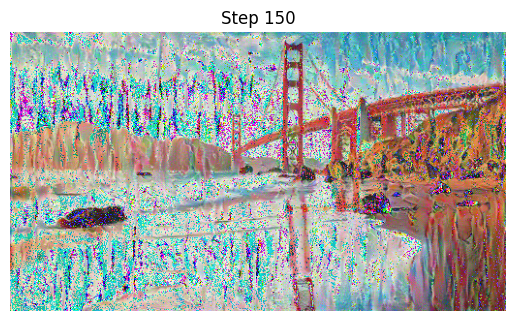

Step 200, Loss: 5.834275245666504


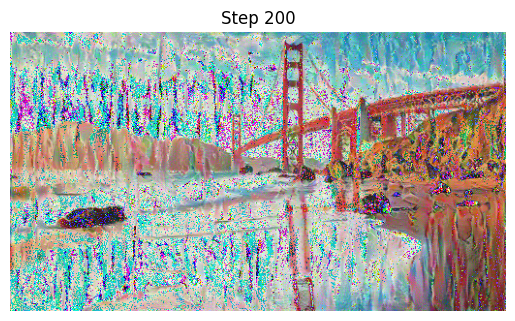

Step 250, Loss: 5.4697442054748535


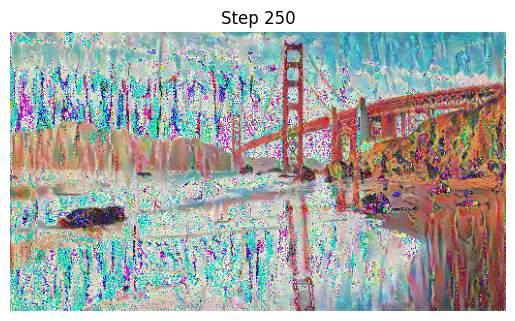

Step 300, Loss: 5.211577415466309


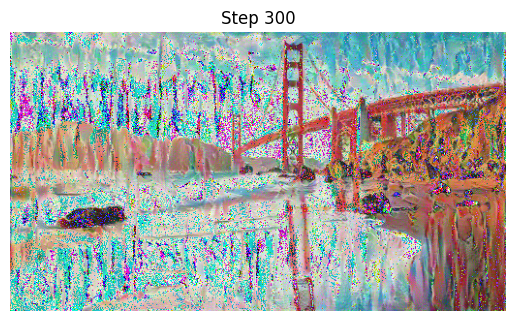

Step 350, Loss: 5.0251312255859375


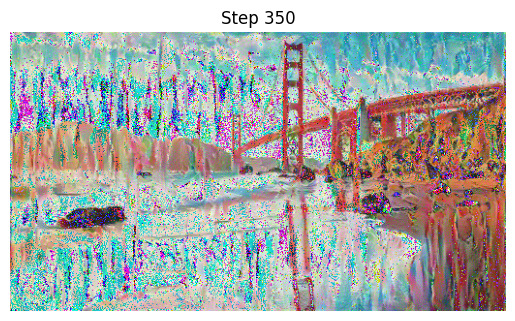

Step 400, Loss: 4.866384029388428


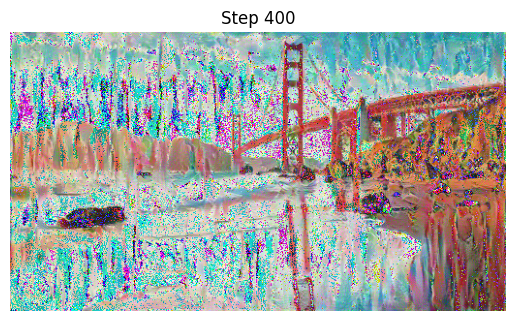

Step 450, Loss: 4.750194549560547


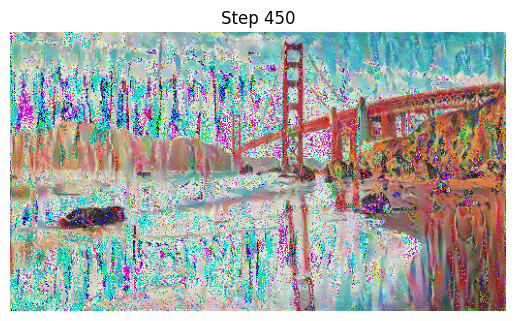

Step 500, Loss: 4.6387939453125


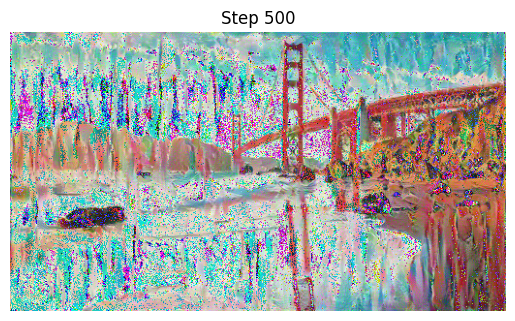

Step 550, Loss: 4.565886497497559


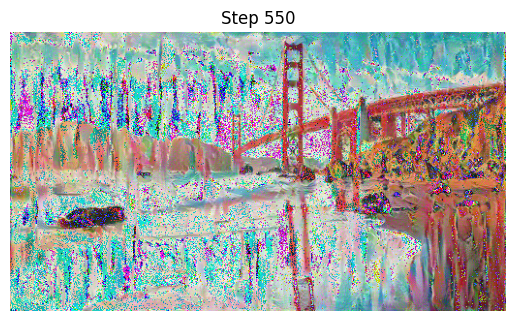

Step 600, Loss: 4.509655952453613


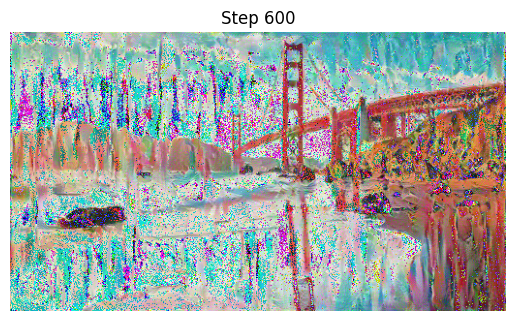

Generated image saved to generated_image.jpg


In [ ]:
# Import required libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt

# Define device (GPU if available, else CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to visualize an image
def imshow(tensor, title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Function to load an image from a URL
def load_image_from_url(url, max_size=None, shape=None):
    response = requests.get(url)
    image = Image.open(BytesIO(response.content)).convert('RGB')
    if max_size:
        scale = max_size / max(image.size)
        size = (int(image.size[0] * scale), int(image.size[1] * scale))
        image = image.resize(size, Image.Resampling.LANCZOS)  # Use LANCZOS for resizing
    if shape:
        image = image.resize(shape, Image.Resampling.LANCZOS)
    transform = transforms.ToTensor()
    image = transform(image).unsqueeze(0)
    return image

# Image URLs
style_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
content_url = "https://www.sftravel.com/sites/default/files/styles/hero/public/2022-10/baker-beach.jpg.webp?itok=AlgDdT1G"

# Load content and style images
content_img = load_image_from_url(content_url, max_size=512)  # Increase size for better quality
style_img = load_image_from_url(style_url, shape=content_img.shape[-2:])

# Move images to GPU if available
content_img = content_img.to(device)
style_img = style_img.to(device)

# Load pre-trained VGG19 model
vgg = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features

# Freeze all the parameters
for param in vgg.parameters():
    param.requires_grad_(False)

# Move the model to GPU if available
vgg.to(device)

# Define Content Loss
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = torch.mean((input - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

# Define Style Loss
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = self.gram_matrix(target_feature).detach()

    def forward(self, input):
        G = self.gram_matrix(input)
        self.loss = torch.mean((G - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

    def gram_matrix(self, input):
        a, b, c, d = input.size()
        features = input.view(a * b, c * d)
        G = torch.mm(features, features.t())
        return G.div(a * b * c * d)

# Layers for content and style
content_layers = ['21']  # Layer 21 corresponds to 'conv4_2' in VGG19
style_layers = ['0', '5', '10', '19', '28']  # Layers for style extraction

# Extract features
def get_features(image, model, layers):
    features = {}
    x = image
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[name] = x
    return features

# Initialize the generated image
generated_img = content_img.clone() + torch.randn_like(content_img) * 0.1  # Add noise
generated_img = generated_img.requires_grad_(True)

# Optimizer
optimizer = optim.Adam([generated_img], lr=0.01)  # Use Adam optimizer

# Training loop
num_steps = 600
style_weight = 1e7  # Default style weight
for step in range(num_steps):
    def closure():
        optimizer.zero_grad()
        content_features = get_features(content_img, vgg, content_layers)
        style_features = get_features(style_img, vgg, style_layers)
        generated_features = get_features(generated_img, vgg, content_layers + style_layers)

        # Compute content loss
        content_loss = 0
        for layer in content_layers:
            _, loss = ContentLoss(content_features[layer])(generated_features[layer])
            content_loss += loss

        # Compute style loss
        style_loss = 0
        for layer in style_layers:
            _, loss = StyleLoss(style_features[layer])(generated_features[layer])
            style_loss += loss

        # Total loss
        total_loss = content_loss + style_loss * style_weight
        total_loss.backward()
        return total_loss

    optimizer.step(closure)

    if step % 50 == 0:
        print(f"Step {step}, Loss: {closure().item()}")
        # Visualize the generated image
        with torch.no_grad():
            imshow(generated_img, title=f"Step {step}")

# Show the final result after 300 steps
print(f"Step {num_steps}, Loss: {closure().item()}")
with torch.no_grad():
    imshow(generated_img, title=f"Step {num_steps}")

# Save the final generated image
output_path = 'generated_image.jpg'
output_image = transforms.ToPILImage()(generated_img.cpu().squeeze(0))
output_image.save(output_path)
print(f"Generated image saved to {output_path}")

Step 0, Loss: 10.173888206481934


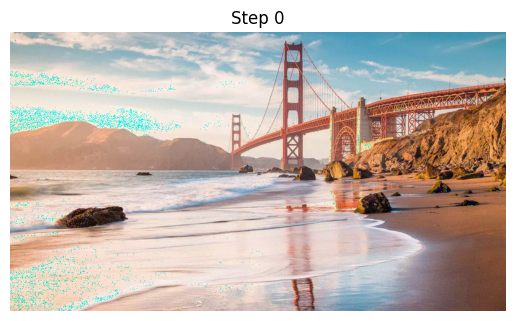

Step 50, Loss: 3.9383203983306885


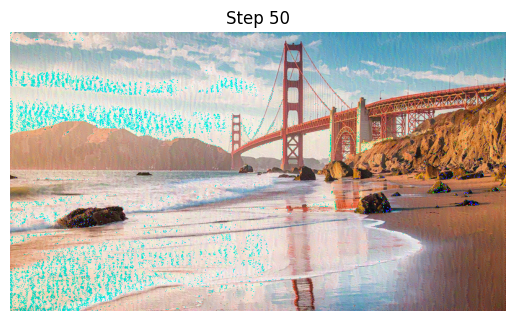

Step 100, Loss: 2.557342767715454


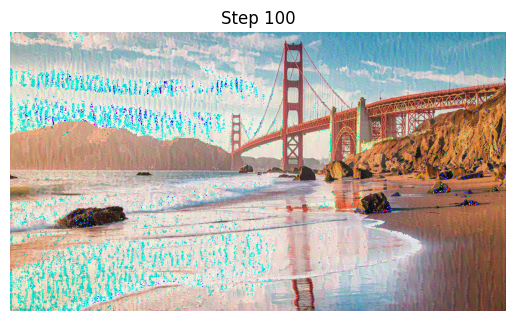

Step 150, Loss: 2.088862180709839


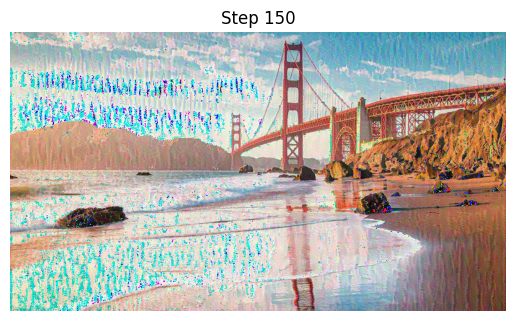

Step 200, Loss: 1.8648619651794434


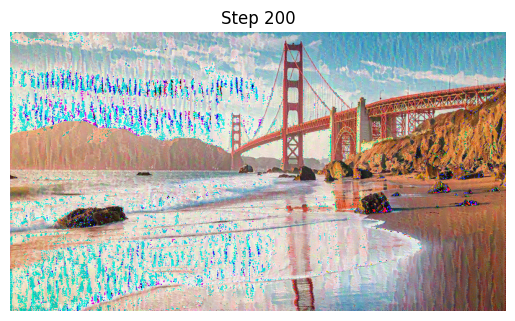

Step 250, Loss: 1.730424404144287


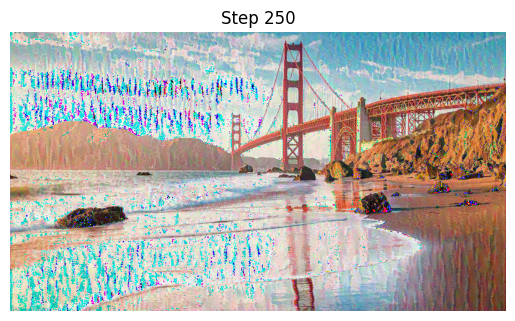

Step 300, Loss: 1.6389296054840088


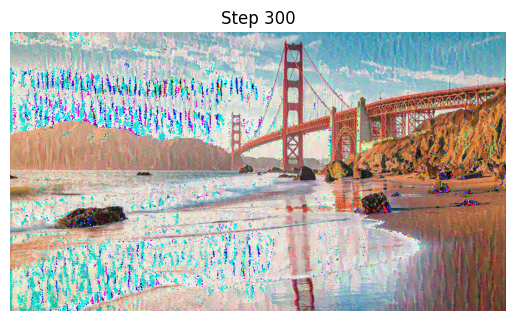

Step 350, Loss: 1.5713856220245361


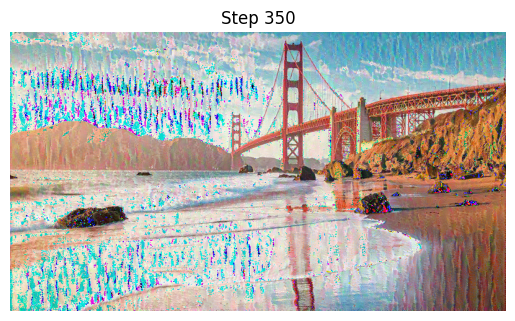

Step 400, Loss: 1.519502878189087


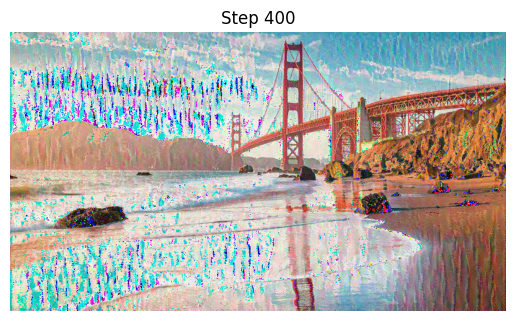

Step 450, Loss: 1.4776880741119385


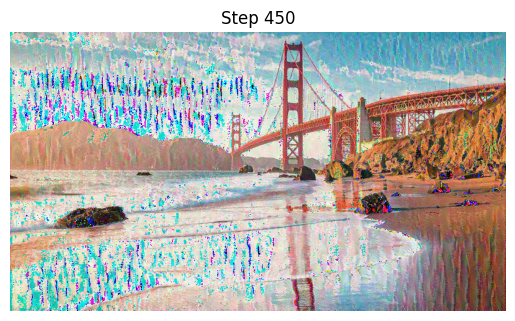

Step 500, Loss: 1.4436689615249634


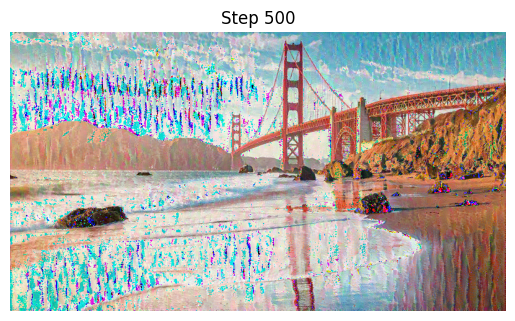

Generated image saved to generated_image.jpg


In [ ]:
# Import required libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt

# Define device (GPU if available, else CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to visualize an image
def imshow(tensor, title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Function to load an image from a URL
def load_image_from_url(url, max_size=None, shape=None):
    response = requests.get(url)
    image = Image.open(BytesIO(response.content)).convert('RGB')
    if max_size:
        scale = max_size / max(image.size)
        size = (int(image.size[0] * scale), int(image.size[1] * scale))
        image = image.resize(size, Image.Resampling.LANCZOS)  # Use LANCZOS for resizing
    if shape:
        image = image.resize(shape, Image.Resampling.LANCZOS)
    transform = transforms.ToTensor()
    image = transform(image).unsqueeze(0)
    return image

# Updated Image URLs
style_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
content_url = "https://www.sftravel.com/sites/default/files/styles/hero/public/2022-10/baker-beach.jpg.webp?itok=AlgDdT1G"

# Load content and style images
content_img = load_image_from_url(content_url, max_size=800)  # Larger size
style_img = load_image_from_url(style_url, shape=content_img.shape[-2:])

# Move images to GPU if available
content_img = content_img.to(device)
style_img = style_img.to(device)

# Load pre-trained VGG19 model
vgg = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features

# Freeze all the parameters
for param in vgg.parameters():
    param.requires_grad_(False)

# Move the model to GPU if available
vgg.to(device)

# Define Content Loss
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = torch.mean((input - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

# Define Style Loss
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = self.gram_matrix(target_feature).detach()

    def forward(self, input):
        G = self.gram_matrix(input)
        self.loss = torch.mean((G - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

    def gram_matrix(self, input):
        a, b, c, d = input.size()
        features = input.view(a * b, c * d)
        G = torch.mm(features, features.t())
        return G.div(a * b * c * d)

# Define Total Variation Loss
def total_variation_loss(image):
    tv_loss = torch.sum(torch.abs(image[:, :, :, :-1] - image[:, :, :, 1:])) + \
              torch.sum(torch.abs(image[:, :, :-1, :] - image[:, :, 1:, :]))
    return tv_loss

# Layers for content and style
content_layers = ['21']  # Layer 21 corresponds to 'conv4_2' in VGG19
style_layers = ['0', '5', '10', '19', '28']  # Layers for style extraction

# Extract features
def get_features(image, model, layers):
    features = {}
    x = image
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[name] = x
    return features

# Initialize the generated image
generated_img = content_img.clone() + torch.randn_like(content_img) * 0.01  # Reduced noise
generated_img = generated_img.requires_grad_(True)

# Optimizer
optimizer = optim.Adam([generated_img], lr=0.001)  # Smaller learning rate

# Training loop
num_steps = 500  # Increased iterations
style_weight = 5e5  # Adjusted style weight
tv_weight = 1e-6  # Total Variation Loss weight
for step in range(num_steps):
    def closure():
        optimizer.zero_grad()
        content_features = get_features(content_img, vgg, content_layers)
        style_features = get_features(style_img, vgg, style_layers)
        generated_features = get_features(generated_img, vgg, content_layers + style_layers)

        # Compute content loss
        content_loss = 0
        for layer in content_layers:
            _, loss = ContentLoss(content_features[layer])(generated_features[layer])
            content_loss += loss

        # Compute style loss
        style_loss = 0
        for layer in style_layers:
            _, loss = StyleLoss(style_features[layer])(generated_features[layer])
            style_loss += loss

        # Compute Total Variation Loss
        tv_loss = total_variation_loss(generated_img) * tv_weight

        # Total loss
        total_loss = content_loss + style_loss * style_weight + tv_loss
        total_loss.backward()
        return total_loss

    optimizer.step(closure)

    if step % 50 == 0:
        print(f"Step {step}, Loss: {closure().item()}")
        # Visualize the generated image
        with torch.no_grad():
            imshow(generated_img, title=f"Step {step}")

# Show the final result after 500 steps
print(f"Step {num_steps}, Loss: {closure().item()}")
with torch.no_grad():
    imshow(generated_img, title=f"Step {num_steps}")

# Save the final generated image
output_path = 'generated_image.jpg'
output_image = transforms.ToPILImage()(generated_img.cpu().squeeze(0))
output_image.save(output_path)
print(f"Generated image saved to {output_path}")

Step 0, Loss: 10.314608573913574


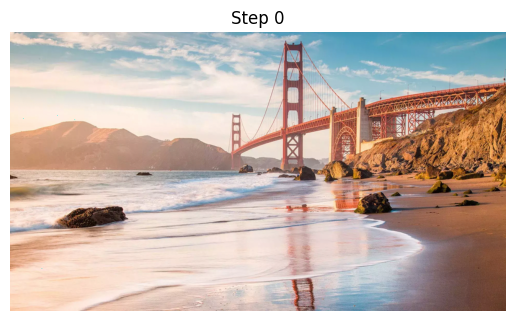

Step 50, Loss: 3.9582736492156982


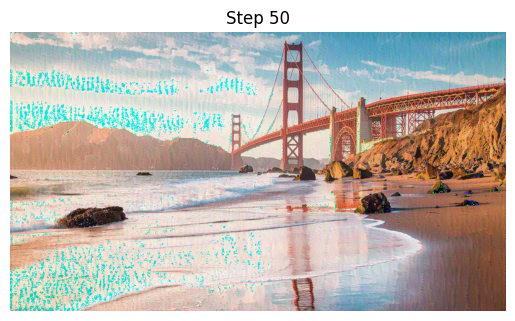

Step 100, Loss: 2.534043073654175


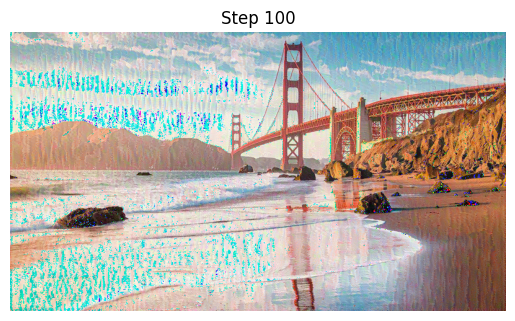

Step 150, Loss: 2.073263645172119


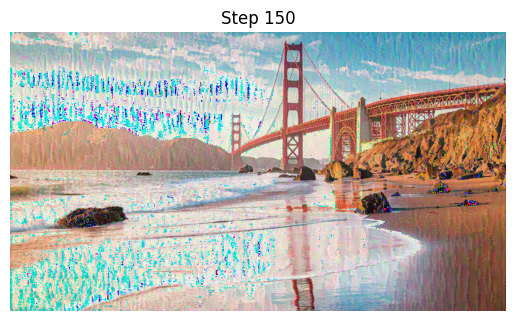

Step 200, Loss: 1.853792667388916


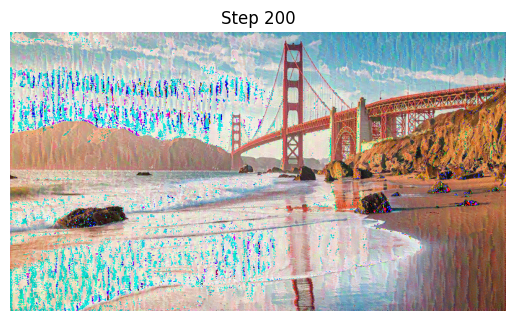

Step 250, Loss: 1.722197413444519


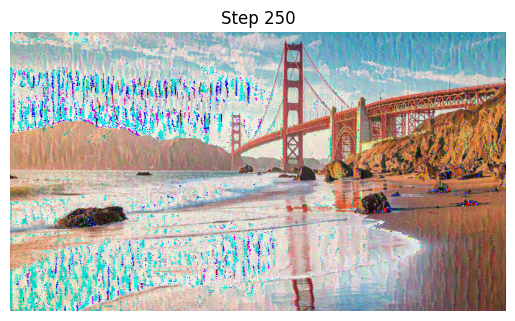

Step 300, Loss: 1.6324245929718018


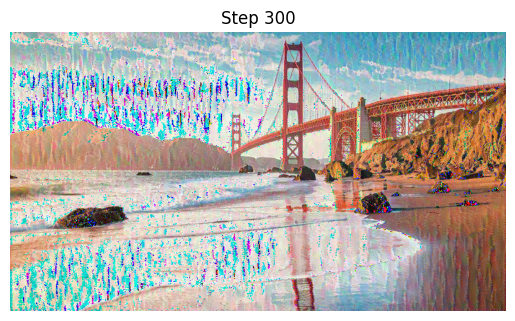

Step 350, Loss: 1.5661872625350952


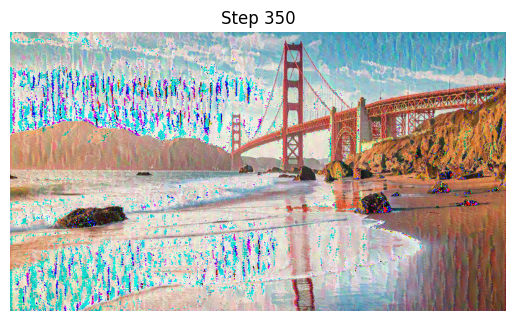

Step 400, Loss: 1.5151112079620361


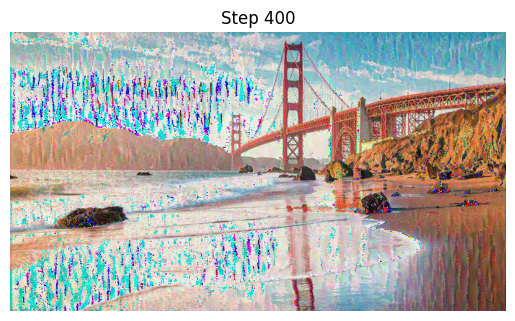

Step 450, Loss: 1.4742881059646606


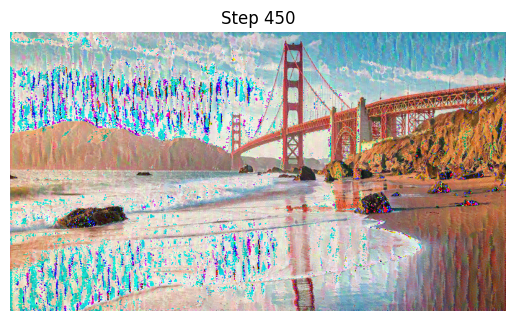

Step 500, Loss: 1.4412933588027954


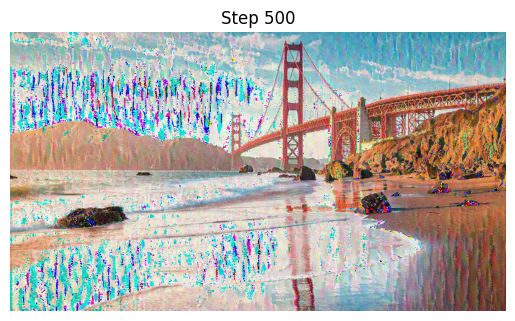

Generated image saved to generated_image.jpg


In [ ]:
# Import required libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt

# Define device (GPU if available, else CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to visualize an image
def imshow(tensor, title=None):
    image = tensor.cpu().clone().squeeze(0)
    image = transforms.ToPILImage()(image)
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Function to load an image from a URL
def load_image_from_url(url, max_size=None, shape=None):
    response = requests.get(url)
    image = Image.open(BytesIO(response.content)).convert('RGB')
    if max_size:
        scale = max_size / max(image.size)
        size = (int(image.size[0] * scale), int(image.size[1] * scale))
        image = image.resize(size, Image.Resampling.LANCZOS)  # Use LANCZOS for resizing
    if shape:
        image = image.resize(shape, Image.Resampling.LANCZOS)
    transform = transforms.ToTensor()
    image = transform(image).unsqueeze(0)
    return image

# Updated Image URLs
style_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
content_url = "https://www.sftravel.com/sites/default/files/styles/hero/public/2022-10/baker-beach.jpg.webp?itok=AlgDdT1G"

# Load content and style images
content_img = load_image_from_url(content_url, max_size=800)  # Larger size
style_img = load_image_from_url(style_url, shape=content_img.shape[-2:])

# Move images to GPU if available
content_img = content_img.to(device)
style_img = style_img.to(device)

# Load pre-trained VGG19 model
vgg = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features

# Freeze all the parameters
for param in vgg.parameters():
    param.requires_grad_(False)

# Move the model to GPU if available
vgg.to(device)

# Define Content Loss
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = torch.mean((input - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

# Define Style Loss
class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = self.gram_matrix(target_feature).detach()

    def forward(self, input):
        G = self.gram_matrix(input)
        self.loss = torch.mean((G - self.target) ** 2)
        return input, self.loss  # Return both the input and the loss

    def gram_matrix(self, input):
        a, b, c, d = input.size()
        features = input.view(a * b, c * d)
        G = torch.mm(features, features.t())
        return G.div(a * b * c * d)

# Define Total Variation Loss
def total_variation_loss(image):
    tv_loss = torch.sum(torch.abs(image[:, :, :, :-1] - image[:, :, :, 1:])) + \
              torch.sum(torch.abs(image[:, :, :-1, :] - image[:, :, 1:, :]))
    return tv_loss

# Layers for content and style
content_layers = ['21']  # Layer 21 corresponds to 'conv4_2' in VGG19
style_layers = ['0', '5', '10', '19', '28']  # Layers for style extraction

# Extract features
def get_features(image, model, layers):
    features = {}
    x = image
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[name] = x
    return features

# Initialize the generated image
generated_img = content_img.clone() + torch.randn_like(content_img) * 0.001  # Reduced noise
generated_img = generated_img.requires_grad_(True)

# Optimizer
optimizer = optim.Adam([generated_img], lr=0.001)  # Smaller learning rate

# Training loop
num_steps = 500  # Increased iterations
style_weight = 5e5  # Adjusted style weight
tv_weight = 1e-6  # Total Variation Loss weight
for step in range(num_steps):
    def closure():
        optimizer.zero_grad()
        content_features = get_features(content_img, vgg, content_layers)
        style_features = get_features(style_img, vgg, style_layers)
        generated_features = get_features(generated_img, vgg, content_layers + style_layers)

        # Compute content loss
        content_loss = 0
        for layer in content_layers:
            _, loss = ContentLoss(content_features[layer])(generated_features[layer])
            content_loss += loss

        # Compute style loss
        style_loss = 0
        for layer in style_layers:
            _, loss = StyleLoss(style_features[layer])(generated_features[layer])
            style_loss += loss

        # Compute Total Variation Loss
        tv_loss = total_variation_loss(generated_img) * tv_weight

        # Total loss
        total_loss = content_loss + style_loss * style_weight + tv_loss
        total_loss.backward()
        return total_loss

    optimizer.step(closure)

    if step % 50 == 0:
        print(f"Step {step}, Loss: {closure().item()}")
        # Visualize the generated image
        with torch.no_grad():
            imshow(generated_img, title=f"Step {step}")

# Show the final result after 500 steps
print(f"Step {num_steps}, Loss: {closure().item()}")
with torch.no_grad():
    imshow(generated_img, title=f"Step {num_steps}")

# Save the final generated image
output_path = 'generated_image.jpg'
output_image = transforms.ToPILImage()(generated_img.cpu().squeeze(0))
output_image.save(output_path)
print(f"Generated image saved to {output_path}")

# Updates: 03/18/25
- Use original photo without noise for better result in initial training
- Compare hyperparameters (style weight, number of steps, learning rate) and optimizer (Adam, LBFGS)
  - LBFGS Optimizer has better result but slow (5 min vs 18 sec)
    : reduce number of steps to 200 takes 3 minutes
  - style weight for our project's parameter alpha
- Apply OOP design (code before applying OOP design is at the bottom section)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import time
from google.colab import drive
import os

drive.mount('/gdrive', force_remount=True)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


class ImageLoader:
    """Class for loading images from URLs and preprocessing them"""
    def __init__(self, max_dim=512):
        self.max_dim = max_dim

    def load_image_from_url(self, url):
        """Loads an image from a URL, resizes it, and converts it to a tensor"""
        response = requests.get(url)
        image = Image.open(BytesIO(response.content)).convert('RGB')
        long = max(image.size)
        scale = self.max_dim / long
        image = image.resize((round(image.size[0] * scale), round(image.size[1] * scale)), Image.LANCZOS)

        transform = transforms.Compose([
            transforms.ToTensor(),
        ])

        return transform(image).unsqueeze(0).to(device)


class VGGFeatures:
    """Class for extracting features from a pre-trained VGG19 model"""
    def __init__(self):
        self.model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features.to(device).eval()
        for param in self.model.parameters():
            param.requires_grad_(False)

    def get_features(self, image, layers):
        """Extracts feature maps from specific layers"""
        features = {}
        x = image
        for name, layer in self.model._modules.items():
            x = layer(x)
            if name in layers:
                features[name] = x
        return features

    @staticmethod
    def gram_matrix(tensor):
        """Computes the Gram matrix for style representation"""
        b, c, h, w = tensor.size()
        features = tensor.view(c, h * w)
        return torch.mm(features, features.t()) / (c * h * w)


class StyleTransfer:
    """Main class for performing style transfer"""
    def __init__(self, content_url, style_url, style_weight=5e7, num_steps=400, lr=0.003, optimizer_type="Adam"):
        self.style_weight = style_weight
        self.num_steps = num_steps
        self.lr = lr
        self.optimizer_type = optimizer_type  # Adam or LBFGS

        # Load images
        loader = ImageLoader()
        self.content_img = loader.load_image_from_url(content_url)
        self.style_img = loader.load_image_from_url(style_url)

        # Load pre-trained VGG19 model
        self.vgg = VGGFeatures()

        # Define content and style layers
        self.content_layers = ['22']  # Conv4_2
        self.style_layers = ['0', '5', '10', '19', '28']

        # Extract content and style features
        self.content_features = self.vgg.get_features(self.content_img, self.content_layers)
        self.style_features = self.vgg.get_features(self.style_img, self.style_layers)

        # Compute Gram matrices for style layers
        self.style_grams = {layer: self.vgg.gram_matrix(self.style_features[layer]) for layer in self.style_layers}

        # Initialize generated image
        self.generated_img = self.content_img.clone().requires_grad_(True)

        # Choose optimizer
        if self.optimizer_type == "LBFGS":
            self.optimizer = optim.LBFGS([self.generated_img])
        else:  # Default to Adam
            self.optimizer = optim.Adam([self.generated_img], lr=self.lr)

        # Store intermediate images
        self.images_at_steps = []

    def show_initial_images(self):
        """Displays content and style images before training starts"""
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))

        # Convert tensors to PIL images
        content_pil = transforms.ToPILImage()(self.content_img.cpu().squeeze(0).clamp(0, 1))
        style_pil = transforms.ToPILImage()(self.style_img.cpu().squeeze(0).clamp(0, 1))

        # Show images
        ax[0].imshow(content_pil)
        ax[0].set_title("Content Image")
        ax[0].axis("off")

        ax[1].imshow(style_pil)
        ax[1].set_title("Style Image")
        ax[1].axis("off")

        plt.show()

    def train(self):
        """Runs the optimization process for style transfer"""
        self.show_initial_images()  # Show content & style images

        if self.optimizer_type == "LBFGS":
            self.train_lbfgs()
        else:
            self.train_adam()

        self.show_progress()
        self.save_image()

    def train_adam(self):
        """Trains the model using Adam optimizer"""
        for step in range(self.num_steps):
            self.optimizer.zero_grad()

            # Extract features from the generated image
            generated_features = self.vgg.get_features(self.generated_img, self.content_layers + self.style_layers)

            # Compute losses
            content_loss, style_loss = self.compute_losses(generated_features)

            # Compute total loss
            total_loss = content_loss + style_loss * self.style_weight
            total_loss.backward()
            self.optimizer.step()

            # Store image at key steps
            if step % 50 == 0:
                print(f"Step {step}, Loss: {total_loss.item()}")
                self.images_at_steps.append(self.generated_img.clone().detach())

    def train_lbfgs(self):
        """Trains the model using LBFGS optimizer"""
        loss_value = None  # Store loss for printing

        def closure():
            nonlocal loss_value  # Capture loss variable
            self.optimizer.zero_grad()
            generated_features = self.vgg.get_features(self.generated_img, self.content_layers + self.style_layers)
            content_loss, style_loss = self.compute_losses(generated_features)
            total_loss = content_loss + style_loss * self.style_weight
            total_loss.backward()

            loss_value = total_loss.item()  # Store loss for printing
            return total_loss

        for step in range(self.num_steps):
            self.optimizer.step(closure)  # Calls closure() internally

            if step % 50 == 0:
                print(f"Step {step}, Loss: {loss_value}")  # Print stored loss
                self.images_at_steps.append(self.generated_img.clone().detach())


    def compute_losses(self, generated_features):
        """Computes content and style loss"""
        content_loss = sum(
            torch.mean((generated_features[layer] - self.content_features[layer]) ** 2)
            for layer in self.content_layers
        )

        style_loss = sum(
            torch.mean((self.vgg.gram_matrix(generated_features[layer]) - self.style_grams[layer]) ** 2)
            for layer in self.style_layers
        )

        return content_loss, style_loss

    def show_progress(self):
        """Displays a sequence of generated images during training"""
        num_images = len(self.images_at_steps)
        fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

        for i, img_tensor in enumerate(self.images_at_steps):
            img_pil = transforms.ToPILImage()(img_tensor.cpu().squeeze(0).clamp(0, 1))
            axes[i].imshow(img_pil)
            axes[i].set_title(f"Step {i * 50}")
            axes[i].axis("off")

        plt.show()

    def save_image(self, output_path='generated_image.jpg'):
        """Saves the final generated image"""
        output_image = transforms.ToPILImage()(self.generated_img.cpu().squeeze(0).clamp(0, 1))
        output_image.save(output_path)
        print(f"Generated image saved to {output_path}")

        # Show final image
        plt.imshow(output_image)
        plt.title("Final Generated Image")
        plt.axis("off")
        plt.show()


Mounted at /gdrive


In [ ]:
# Optimizer: LBFGS -> slow but better result
# Style Weight: BIg

if __name__ == "__main__":
    # Image URLs
    content_url = "https://www.sftravel.com/sites/default/files/styles/hero/public/2022-10/baker-beach.jpg.webp?itok=AlgDdT1G"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x7877ab609350>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

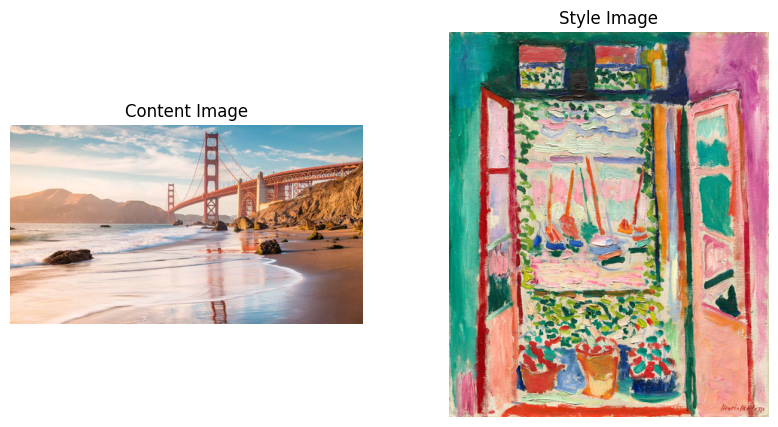

Step 0, Loss: 1.026716709136963
Step 50, Loss: 0.5851941108703613
Step 100, Loss: 0.5763505101203918
Step 150, Loss: 0.5724338889122009


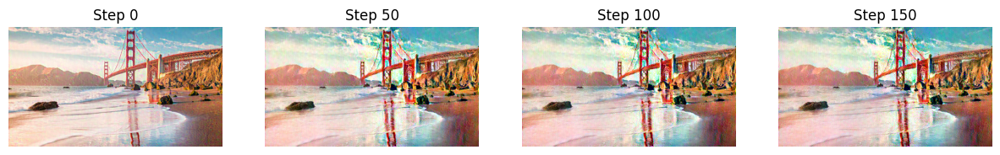

Generated image saved to generated_image.jpg


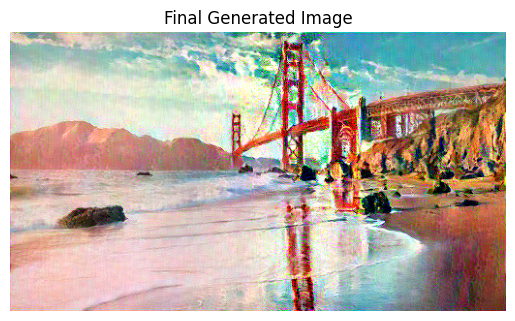

Total Execution Time: 246.12 seconds


In [ ]:
# Optimizer: LBFGS -> slow but better result
# Style Weight: Low

if __name__ == "__main__":
    # Image URLs
    content_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 1e5 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


In [ ]:
# Optimizer: Adam-> faster but looks ok
# Style Weight: Big

if __name__ == "__main__":
    # Image URLs
    content_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 300
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "Adam" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


UnidentifiedImageError: cannot identify image file <_io.BytesIO object at 0x7a18b9646ed0>

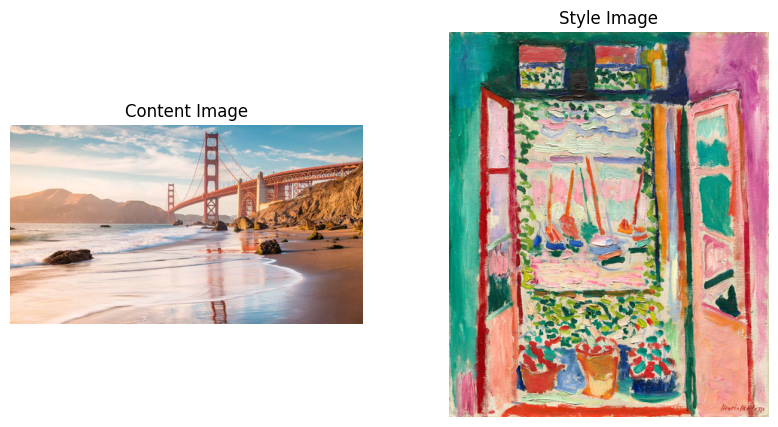

Step 0, Loss: 21.010101318359375
Step 50, Loss: 4.3355712890625
Step 100, Loss: 2.0917627811431885
Step 150, Loss: 2.7673635482788086
Step 200, Loss: 2.1862518787384033
Step 250, Loss: 2.040736198425293


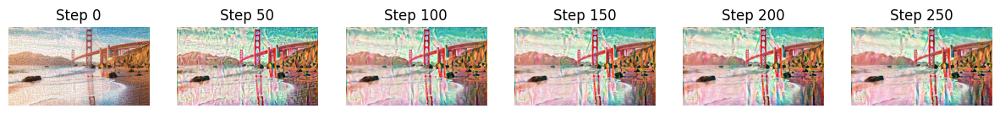

Generated image saved to generated_image.jpg


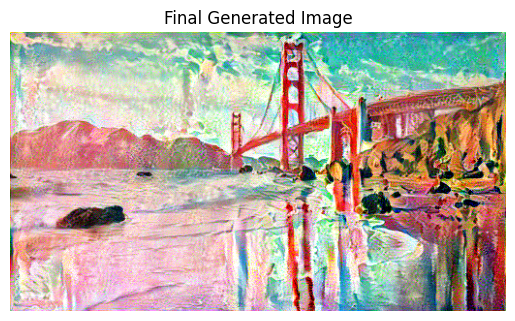

Total Execution Time: 18.71 seconds


In [ ]:
# Optimizer: Adam-> faster but looks ok
# Style Weight: Medium

if __name__ == "__main__":
    # Image URLs
    content_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 1e6 # 1e5 - 5e7
    num_steps = 300
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "Adam" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


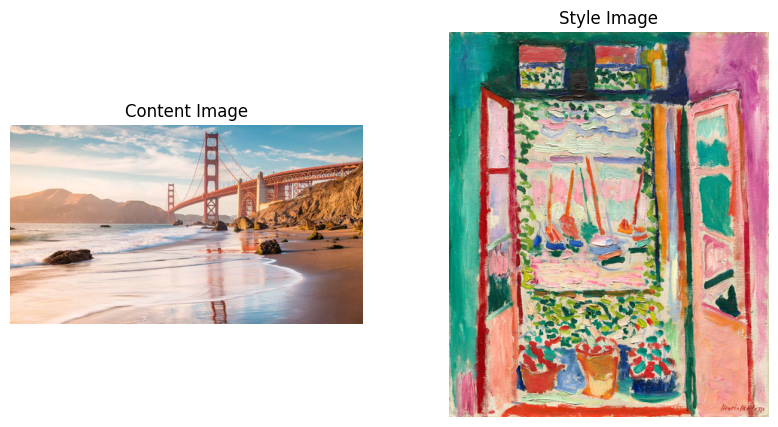

Step 0, Loss: 2.1010100841522217
Step 50, Loss: 1.0816822052001953
Step 100, Loss: 1.0336672067642212
Step 150, Loss: 0.977158784866333
Step 200, Loss: 0.9811944961547852
Step 250, Loss: 0.9303319454193115


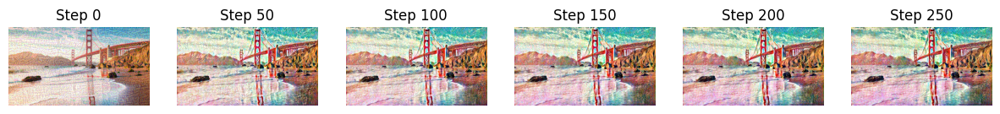

Generated image saved to generated_image.jpg


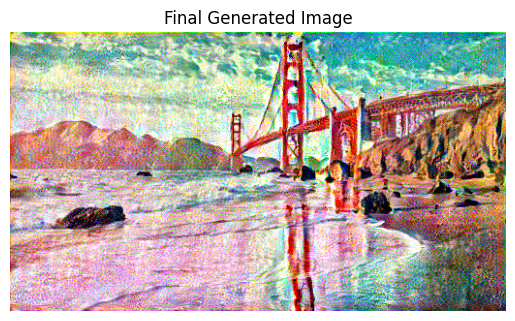

Total Execution Time: 18.21 seconds


In [ ]:
# Optimizer: Adam-> faster but looks ok
# Style Weight: Low

if __name__ == "__main__":
    # Image URLs
    content_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 1e5 # 1e5 - 5e7
    num_steps = 300
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "Adam" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 155MB/s]


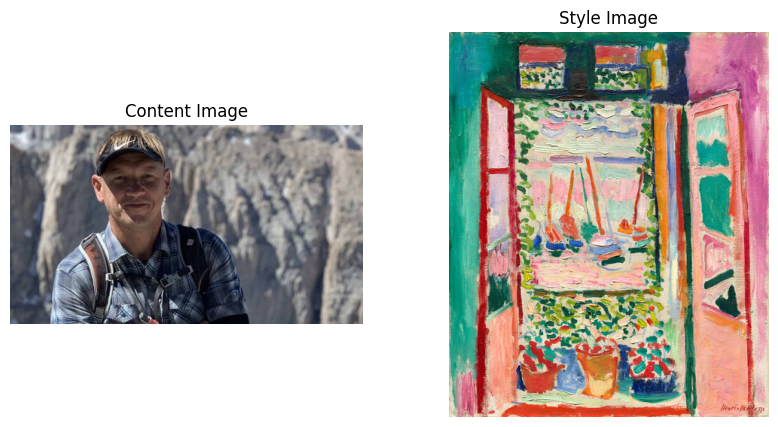

Step 0, Loss: 50.8062629699707
Step 50, Loss: 4.626020431518555
Step 100, Loss: 4.435054302215576
Step 150, Loss: 4.389633655548096


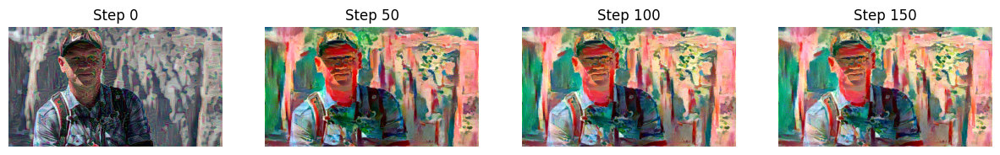

Generated image saved to generated_image.jpg


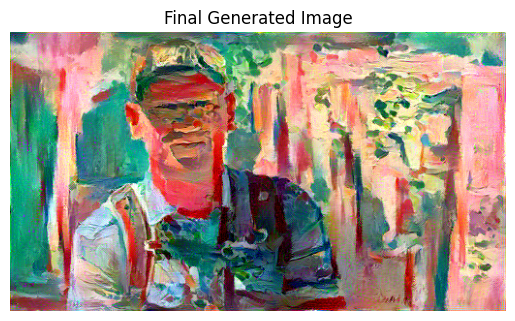

Total Execution Time: 252.79 seconds


In [ ]:
# Optimizer: LBFGS -> slow but better result
# Style Weight: Big

if __name__ == "__main__":
    # Image URLs
    content_url = "https://hikingguy.com/wp-content/uploads/cris-hazzard-hiking-guy-1-960x540.jpg"
    style_url = "https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg"

    # Hyperparameters
    style_weight = 1e5 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


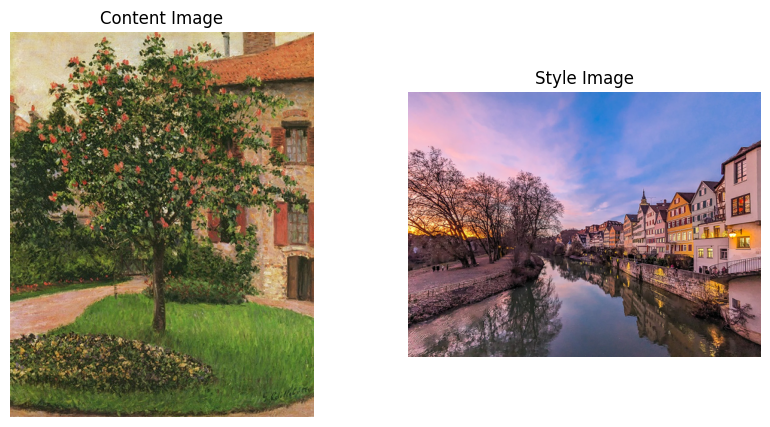

Step 0, Loss: 28.62868309020996
Step 50, Loss: 3.5835843086242676
Step 100, Loss: 3.485313892364502
Step 150, Loss: 3.4547529220581055


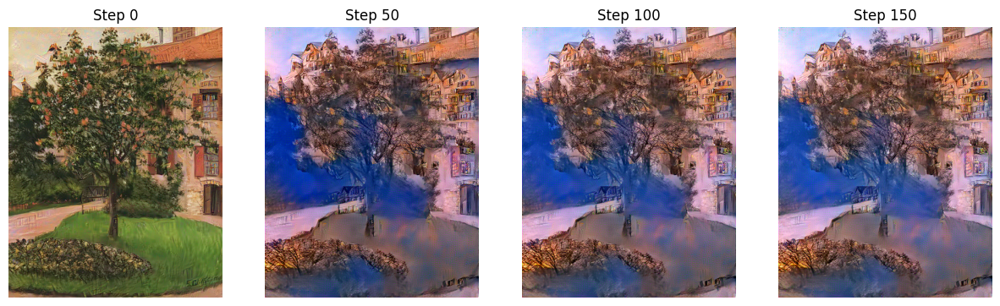

Generated image saved to generated_image.jpg


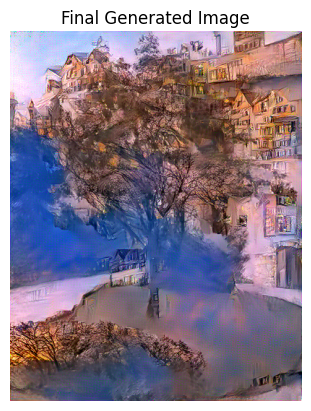

Total Execution Time: 351.72 seconds


In [ ]:
# Optimizer: LBFGS -> slow but better result

if __name__ == "__main__":
    # Image URLs
    content_url = "https://i0.wp.com/parkstone.international/wp-content/uploads/2020/08/Gustave-Caillebotte-Petit-Gennevilliers.jpg"
    style_url = "https://mein.toubiz.de/api/v1/article/10772b9e-6497-4ab6-bf85-4a3a42f9a02d/mainImage?format=image/webp&width=1900"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_url, style_url, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")

# Updates: 4/15/25
- Upload image from the colab folder and use it
- Tried opposite way

In [ ]:
# NVM!!!!!
# Download Image (UPLOAD TO content/sample_image/ DIRECTLY FOR DEMO)

import os

img_dir = '/content/sample_image'

if not os.path.exists(img_dir):
  os.makedirs(img_dir)

#NOOOO !wget -q https://www.avenidas.org/wp-content/uploads/2023/07/baker-beach-bridge-featured-1080x565.jpg -O /content/sample_image/baker_beach.jpg
# !wget -q https://www.henrimatisse.org/assets/img/paintings/the-open-window.jpg -O /content/sample_image/open_window.jpg

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
from google.colab import drive
import os
import time as time
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


class ImageLoader:
    """Class for loading images from URLs or local paths and preprocessing them"""
    def __init__(self, max_dim=512):
        self.max_dim = max_dim

    def load_image_from_url(self, url):
        """Loads an image from a URL"""
        response = requests.get(url)
        image = Image.open(BytesIO(response.content)).convert('RGB')
        return self._process(image)

    def load_image_from_path(self, path):
        """Loads an image from a local path (e.g., Google Drive)"""
        image = Image.open(path).convert('RGB')
        return self._process(image)

    def _process(self, image):
        """Resize and convert image to tensor"""
        long = max(image.size)
        scale = self.max_dim / long
        image = image.resize((round(image.size[0] * scale), round(image.size[1] * scale)), Image.LANCZOS)

        transform = transforms.Compose([
            transforms.ToTensor(),
        ])
        return transform(image).unsqueeze(0).to(device)


class VGGFeatures:
    """Class for extracting features from a pre-trained VGG19 model"""
    def __init__(self):
        self.model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features.to(device).eval()
        for param in self.model.parameters():
            param.requires_grad_(False)

    def get_features(self, image, layers):
        """Extracts feature maps from specific layers"""
        features = {}
        x = image
        for name, layer in self.model._modules.items():
            x = layer(x)
            if name in layers:
                features[name] = x
        return features

    @staticmethod
    def gram_matrix(tensor):
        """Computes the Gram matrix for style representation"""
        b, c, h, w = tensor.size()
        features = tensor.view(c, h * w)
        return torch.mm(features, features.t()) / (c * h * w)


class StyleTransfer:
    """Main class for performing style transfer"""
    def __init__(self, content_path, style_path, style_weight=5e7, num_steps=400, lr=0.003, optimizer_type="Adam"):
        self.style_weight = style_weight
        self.num_steps = num_steps
        self.lr = lr
        self.optimizer_type = optimizer_type  # Adam or LBFGS

        # Load images from file paths
        loader = ImageLoader()
        self.content_img = loader.load_image_from_path(content_path)
        self.style_img = loader.load_image_from_path(style_path)

        # Load pre-trained VGG19 model
        self.vgg = VGGFeatures()

        # Define content and style layers
        self.content_layers = ['22']  # Conv4_2
        self.style_layers = ['0', '5', '10', '19', '28']

        # Extract content and style features
        self.content_features = self.vgg.get_features(self.content_img, self.content_layers)
        self.style_features = self.vgg.get_features(self.style_img, self.style_layers)

        # Compute Gram matrices for style layers
        self.style_grams = {layer: self.vgg.gram_matrix(self.style_features[layer]) for layer in self.style_layers}

        # Initialize generated image
        self.generated_img = self.content_img.clone().requires_grad_(True)

        # Choose optimizer
        if self.optimizer_type == "LBFGS":
            self.optimizer = optim.LBFGS([self.generated_img])
        else:  # Default to Adam
            self.optimizer = optim.Adam([self.generated_img], lr=self.lr)

        # Store intermediate images
        self.images_at_steps = []

    def show_initial_images(self):
        """Displays content and style images before training starts"""
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))

        # Convert tensors to PIL images
        content_pil = transforms.ToPILImage()(self.content_img.cpu().squeeze(0).clamp(0, 1))
        style_pil = transforms.ToPILImage()(self.style_img.cpu().squeeze(0).clamp(0, 1))

        # Show images
        ax[0].imshow(content_pil)
        ax[0].set_title("Content Image")
        ax[0].axis("off")

        ax[1].imshow(style_pil)
        ax[1].set_title("Style Image")
        ax[1].axis("off")

        plt.show()

    def train(self):
        """Runs the optimization process for style transfer"""
        self.show_initial_images()  # Show content & style images

        if self.optimizer_type == "LBFGS":
            self.train_lbfgs()
        else:
            self.train_adam()

        self.show_progress()
        self.save_image()

    def train_adam(self):
        """Trains the model using Adam optimizer"""
        # list for graph
        total_losses = []
        content_losses = []
        style_losses = []

        for step in range(self.num_steps):
            self.optimizer.zero_grad()

            # Extract features
            generated_features = self.vgg.get_features(self.generated_img, self.content_layers + self.style_layers)

            # Compute losses
            content_loss, style_loss = self.compute_losses(generated_features)
            total_loss = content_loss + style_loss * self.style_weight

            # Backprop
            total_loss.backward()
            self.optimizer.step()

            # 그래프용 loss 저장
            total_losses.append(total_loss.item())
            content_losses.append(content_loss.item())
            style_losses.append(style_loss.item())

            # 중간 출력
            if step % 50 == 0:
                print(f"Step {step}, Total Loss: {total_loss.item():.4f}, Content Loss: {content_loss.item():.4f}, Style Loss: {style_loss.item():.10f}")
                self.images_at_steps.append(self.generated_img.clone().detach())

        # --- Graph ---
        plt.figure(figsize=(10, 5))
        plt.plot(total_losses, label='Total Loss')
        plt.plot(content_losses, label='Content Loss')
        plt.plot(style_losses, label='Style Loss')
        plt.xlabel("Step")
        plt.ylabel("Loss")
        plt.title("Adam Loss Curves")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


    def train_lbfgs(self):
        """Trains the model using LBFGS optimizer"""
        loss_value = None
        content_loss_value = None
        style_loss_value = None

        # list for graph
        total_losses = []
        content_losses = []
        style_losses = []

        def closure():
            nonlocal loss_value, content_loss_value, style_loss_value
            self.optimizer.zero_grad()
            generated_features = self.vgg.get_features(self.generated_img, self.content_layers + self.style_layers)
            content_loss, style_loss = self.compute_losses(generated_features)
            total_loss = content_loss + style_loss * self.style_weight
            total_loss.backward()

            # Save loss values for printing & graph
            content_loss_value = content_loss.item()
            style_loss_value = style_loss.item()
            loss_value = total_loss.item()

            return total_loss

        for step in range(self.num_steps):
            self.optimizer.step(closure)

            # Save to graph lists
            total_losses.append(loss_value)
            content_losses.append(content_loss_value)
            style_losses.append(style_loss_value)

            if step % 50 == 0:
                print(f"Step {step}, Total Loss: {loss_value:.4f}, Content Loss: {content_loss_value:.4f}, Style Loss: {style_loss_value:.10f}")
                self.images_at_steps.append(self.generated_img.clone().detach())

        # --- Graph ---
        plt.figure(figsize=(10, 5))
        plt.plot(total_losses, label='Total Loss')
        plt.plot(content_losses, label='Content Loss')
        plt.plot(style_losses, label='Style Loss')
        plt.xlabel("Step")
        plt.ylabel("Loss")
        plt.title("LBFGS Loss Curves")
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


    def compute_losses(self, generated_features):
        """Computes content and style loss"""
        content_loss = sum(
            torch.mean((generated_features[layer] - self.content_features[layer]) ** 2)
            for layer in self.content_layers
        )

        style_loss = sum(
            torch.mean((self.vgg.gram_matrix(generated_features[layer]) - self.style_grams[layer]) ** 2)
            for layer in self.style_layers
        )

        return content_loss, style_loss

    def show_progress(self):
        """Displays a sequence of generated images during training"""
        num_images = len(self.images_at_steps)
        fig, axes = plt.subplots(1, num_images, figsize=(15, 5))

        for i, img_tensor in enumerate(self.images_at_steps):
            img_pil = transforms.ToPILImage()(img_tensor.cpu().squeeze(0).clamp(0, 1))
            axes[i].imshow(img_pil)
            axes[i].set_title(f"Step {i * 50}")
            axes[i].axis("off")

        plt.show()

    def save_image(self, output_path='generated_image.jpg'):
        """Saves the final generated image and prints final losses"""
        # Calculate final losses
        with torch.no_grad():
            features = self.vgg.get_features(self.generated_img, self.content_layers + self.style_layers)
            content_loss, style_loss = self.compute_losses(features)
            total_loss = content_loss + style_loss * self.style_weight

        # Save and show image
        output_image = transforms.ToPILImage()(self.generated_img.cpu().squeeze(0).clamp(0, 1))
        output_image.save(output_path)
        print(f"Generated image saved to {output_path}")

        # Print losses
        print(f"Final Total Loss: {total_loss.item():.4f}")
        print(f"Final Content Loss: {content_loss.item():.4f}")
        print(f"Final Style Loss: {style_loss.item():.10f}")

        # Show image
        plt.imshow(output_image)
        plt.title("Final Generated Image")
        plt.axis("off")
        plt.show()


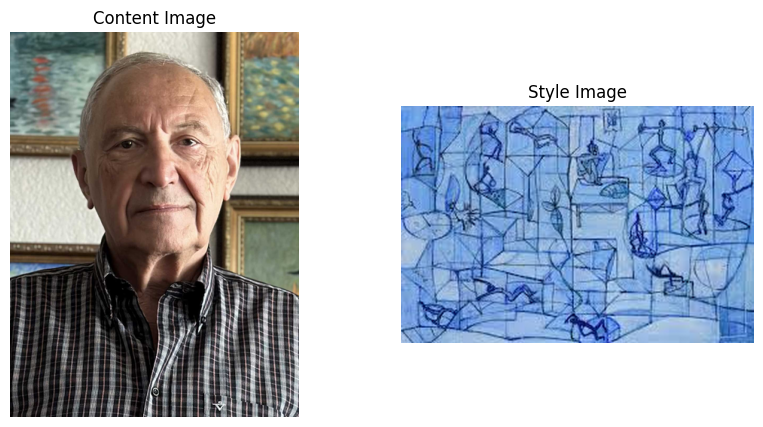

Step 0, Total Loss: 45.2623, Content Loss: 3.0651, Style Loss: 0.0000008439
Step 50, Total Loss: 3.1118, Content Loss: 2.3928, Style Loss: 0.0000000144
Step 100, Total Loss: 2.9713, Content Loss: 2.3373, Style Loss: 0.0000000127


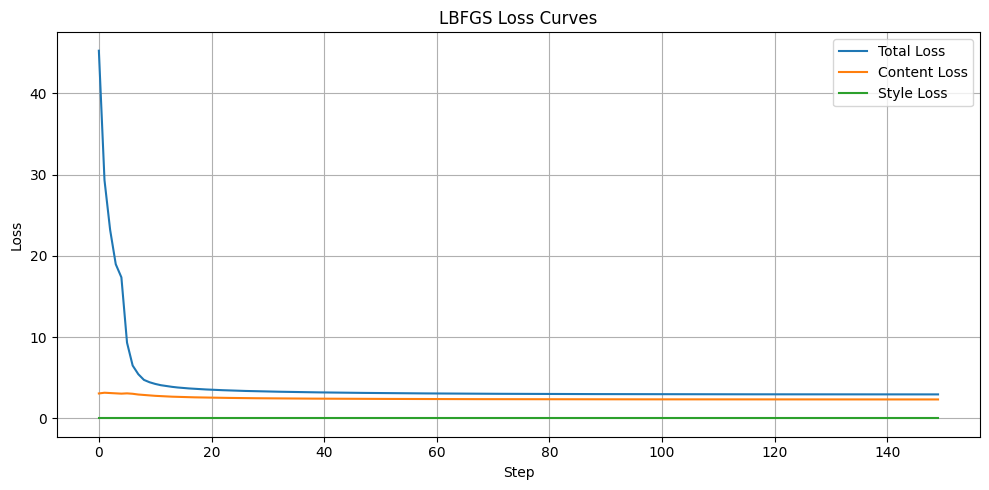

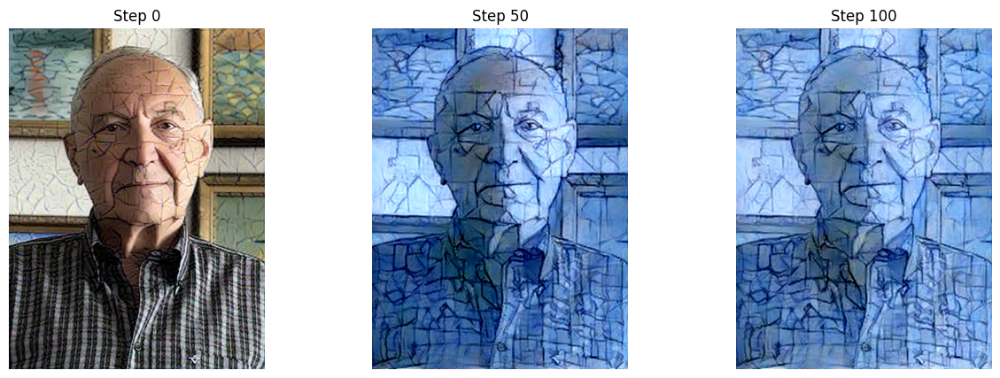

Generated image saved to generated_image.jpg
Final Total Loss: 2.9479
Final Content Loss: 2.3258
Final Style Loss: 0.0000000124


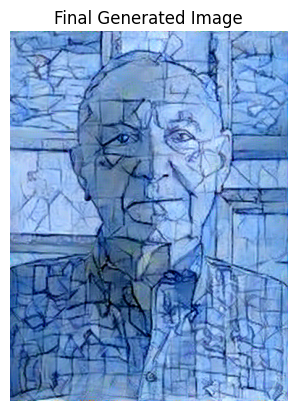

Total Execution Time: 244.94 seconds


In [ ]:
# Optimizer: Adam
# Style Weight: Big

if __name__ == "__main__":
    # Image paths
    content_path = "/content/sample_image/aityan.jpg"
    style_path = "/content/sample_image/blue.jpeg"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 150
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_path, style_path, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 158MB/s]


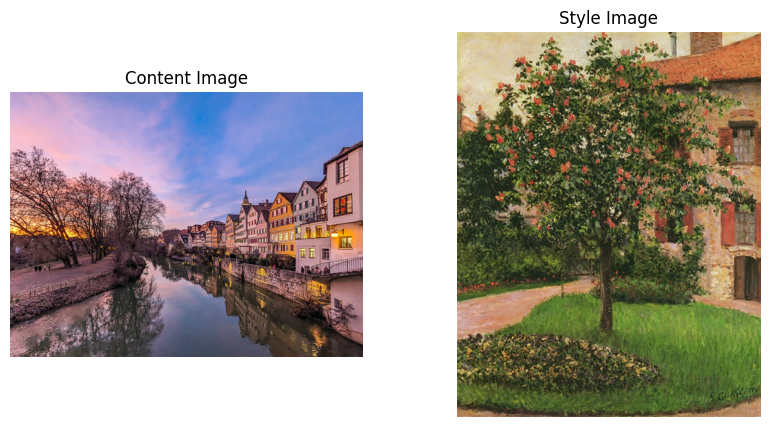

Step 0, Total Loss: 13.8515, Content Loss: 2.4009, Style Loss: 0.0000002290
Step 50, Total Loss: 2.0353, Content Loss: 1.5264, Style Loss: 0.0000000102
Step 100, Total Loss: 2.0078, Content Loss: 1.5125, Style Loss: 0.0000000099
Step 150, Total Loss: 2.0003, Content Loss: 1.5088, Style Loss: 0.0000000098


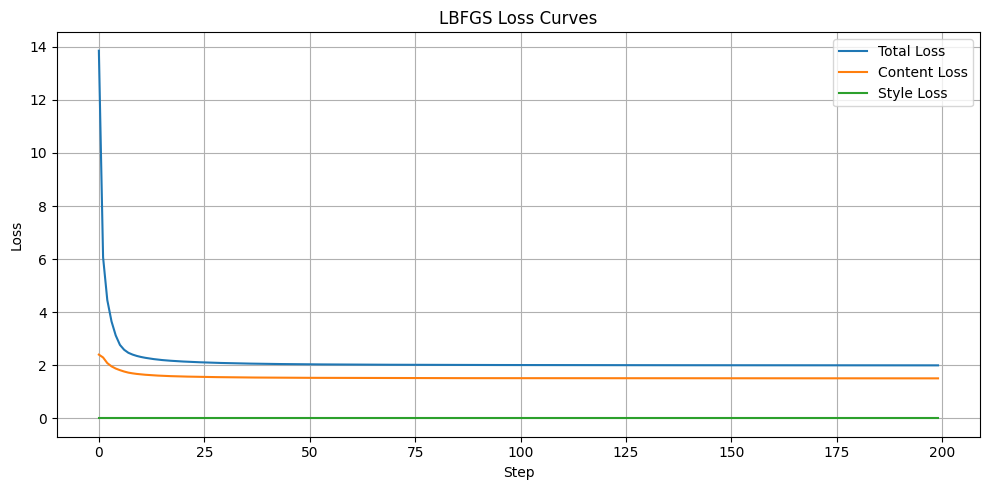

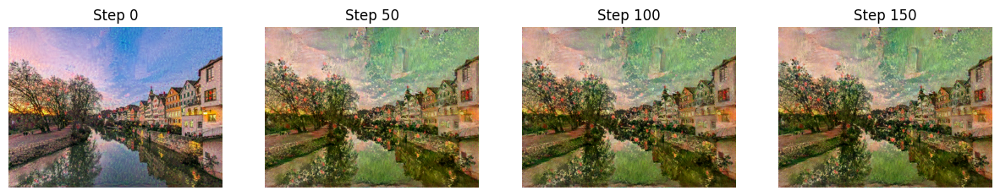

Generated image saved to generated_image.jpg
Final Total Loss: 1.9966
Final Content Loss: 1.5067
Final Style Loss: 0.0000000098


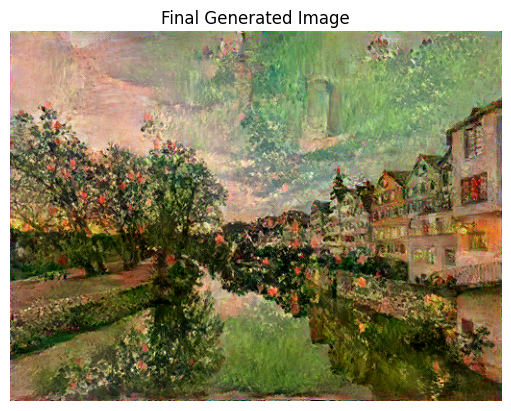

Total Execution Time: 304.50 seconds


In [ ]:
# Optimizer: LBFGS
# Style Weight: Big

if __name__ == "__main__":
    # Image paths
    content_path = "/content/sample_image/neckarfront-tbingen.jpg"
    style_path = "/content/sample_image/Gustave-Caillebotte-Petit-Gennevilliers.jpg"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_path, style_path, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")

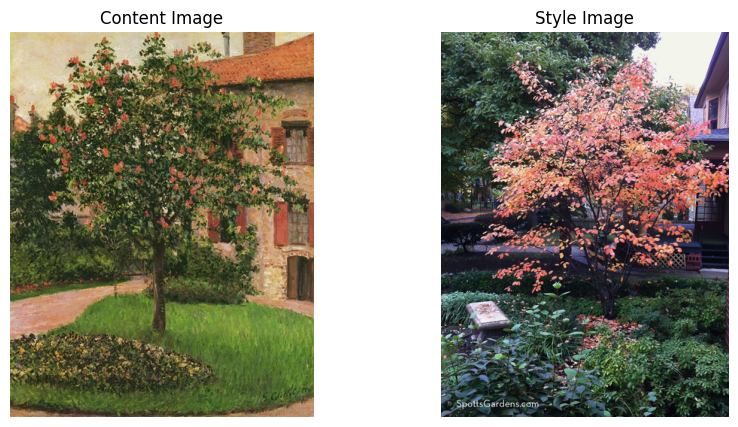

Step 0, Loss: 13.75825309753418
Step 50, Loss: 1.9127049446105957
Step 100, Loss: 1.8584864139556885
Step 150, Loss: 1.8422718048095703


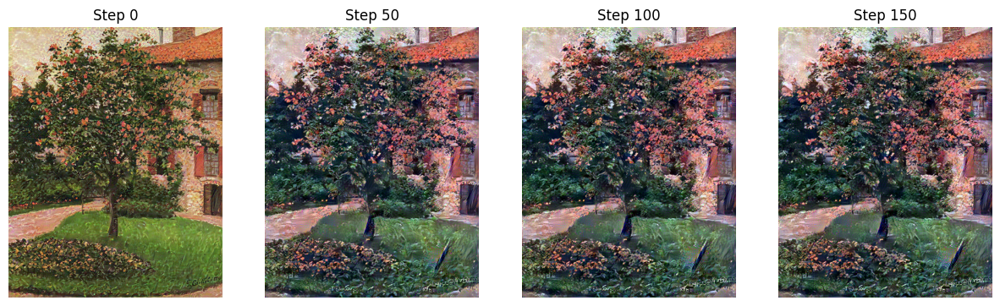

Generated image saved to generated_image.jpg


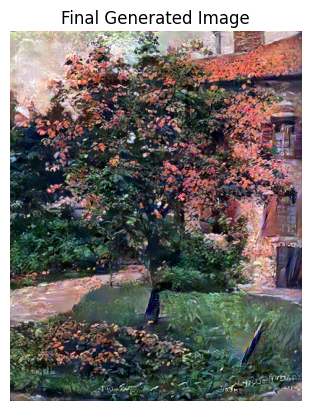

Total Execution Time: 370.30 seconds


In [ ]:
# Optimizer: Adam
# Style Weight: Big

if __name__ == "__main__":
    # Image paths
    content_path = "/content/sample_image/Gustave-Caillebotte-Petit-Gennevilliers.jpg"
    style_path = "/content/sample_image/Amelanchier-x-grandiflora-in-fall.jpg"

    # Hyperparameters
    style_weight = 5e7 # 1e5 - 5e7
    num_steps = 200
    learning_rate = 0.1 # No need for LBFGS
    optimizer_type = "LBFGS" # Adam or LBFGS

    # (optional) Check execution time
    start_time = time.time()

    # Run Style Transfer with selectable optimizer
    style_transfer = StyleTransfer(content_path, style_path, style_weight, num_steps, learning_rate, optimizer_type)
    style_transfer.train()

    # (optional) Check execution time
    end_time = time.time()

    elapsed_time = end_time - start_time
    print(f"Total Execution Time: {elapsed_time:.2f} seconds")

# (Just for Reference) Non-oop

Step 0, Loss: 1050.5050048828125


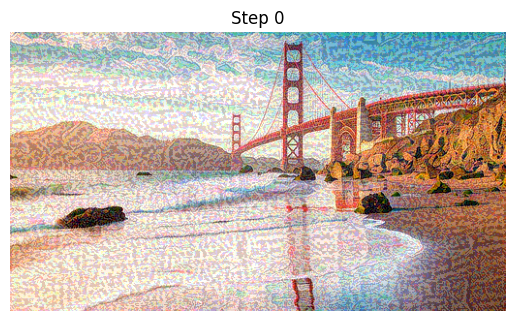

Step 50, Loss: 59.78094482421875


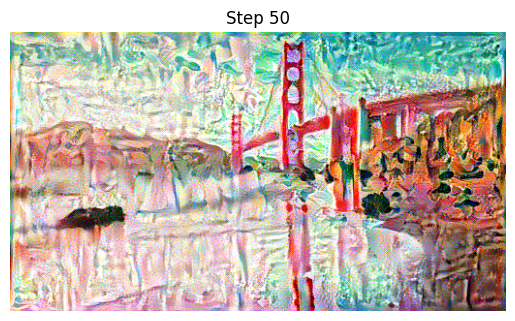

Step 100, Loss: 14.876371383666992


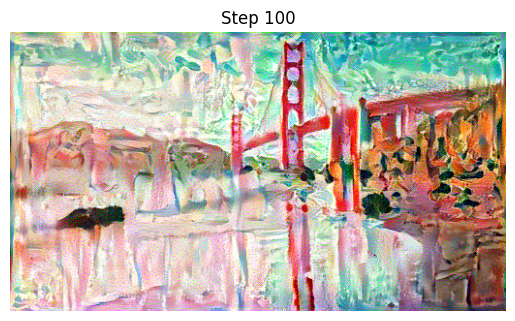

Step 150, Loss: 13.97395133972168


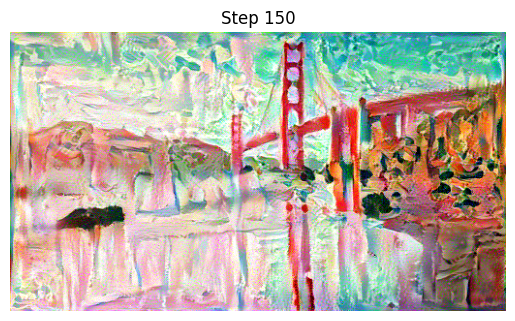

Step 200, Loss: 61.50868606567383


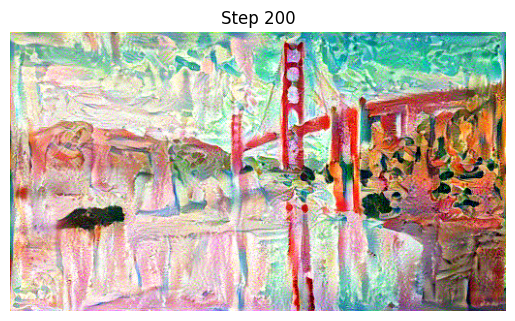

Step 250, Loss: 52.30536651611328


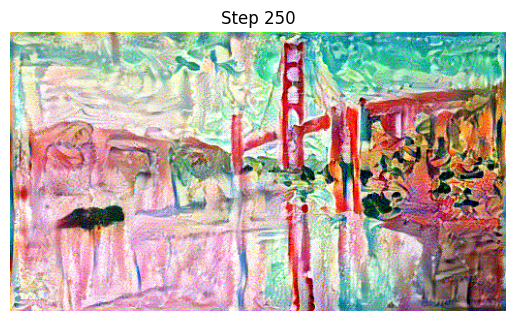

Step 300, Loss: 21.647323608398438


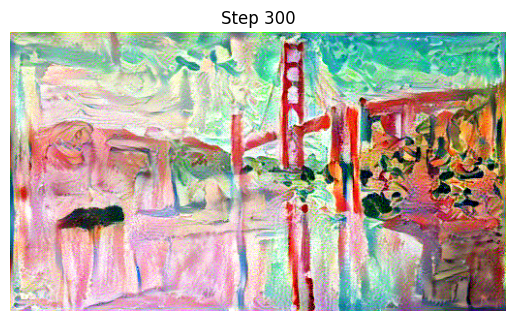

Step 350, Loss: 15.684587478637695


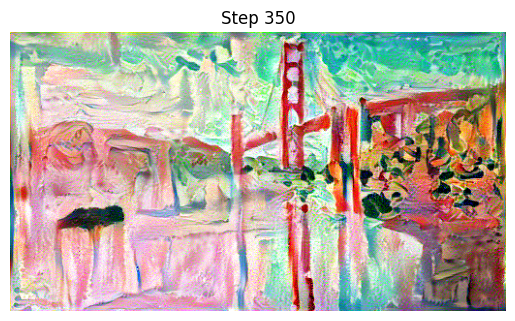

Generated image saved to generated_image.jpg


In [ ]:
# (Ingore it: Before OOP)

import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# image urls
style_url = "https://smarthistory.org/wp-content/uploads/2020/01/matisse-open-window-collioure.jpg"
content_url = "https://www.sftravel.com/sites/default/files/styles/hero/public/2022-10/baker-beach.jpg.webp?itok=AlgDdT1G"

# variables
style_weight = 5e7 # 1e5 - 5e7
num_steps = 400

content_layers = ['21']
style_layers = ['0', '5', '10', '19', '28']

# Function to visualize an image
def imshow(tensor, title=None):
    image = tensor.cpu().clone().detach().squeeze(0)
    image = transforms.ToPILImage()(image.clamp(0, 1))
    plt.imshow(image)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

# Fucntion to load image from url
def load_image_from_url(url, max_size=None, shape=None):
    max_dim = 512
    response = requests.get(url)
    image = Image.open(BytesIO(response.content)).convert('RGB')
    long = max(image.size)
    scale = max_dim / long
    image = image.resize((round(image.size[0] * scale), round(image.size[1] * scale)), Image.LANCZOS)

    transform = transforms.Compose([
        transforms.ToTensor(),
    ])

    image = transform(image).unsqueeze(0)
    return image.to(device)

content_img = load_image_from_url(content_url, max_size=512)
style_img = load_image_from_url(style_url, shape=content_img.shape[-2:])

vgg = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).features.to(device).eval()
for param in vgg.parameters():
    param.requires_grad_(False)

def get_features(image, model, layers):
    features = {}
    x = image
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[name] = x
    return features

content_features = get_features(content_img, vgg, content_layers)
style_features = get_features(style_img, vgg, style_layers)

def gram_matrix(tensor):
    b, c, h, w = tensor.size()
    features = tensor.view(c, h * w)
    return torch.mm(features, features.t()) / (c * h * w)

generated_img = content_img.clone().requires_grad_(True)
optimizer = optim.Adam([generated_img], lr=0.1)

for step in range(num_steps):
    optimizer.zero_grad()

    generated_features = get_features(generated_img, vgg, content_layers + style_layers)

    content_loss = sum(torch.mean((generated_features[layer] - content_features[layer]) ** 2) for layer in content_layers)

    style_loss = sum(torch.mean((gram_matrix(generated_features[layer]) - gram_matrix(style_features[layer])) ** 2)
                     for layer in style_layers)

    total_loss = content_loss + style_loss * style_weight
    total_loss.backward()
    optimizer.step()

    if step % 50 == 0:
        print(f"Step {step}, Loss: {total_loss.item()}")
        with torch.no_grad():
            imshow(generated_img, title=f"Step {step}")

output_path = 'generated_image.jpg'
output_image = transforms.ToPILImage()(generated_img.cpu().squeeze(0).clamp(0, 1))
output_image.save(output_path)
print(f"Generated image saved to {output_path}")

Step 0, Loss: 15.513535499572754


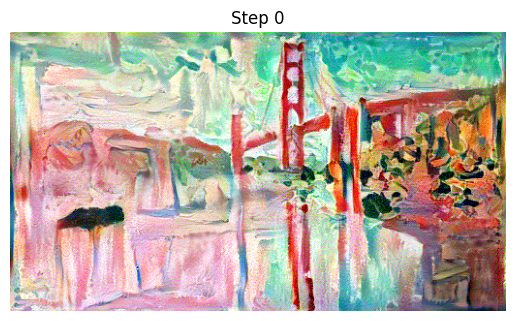

Step 50, Loss: 78.02919006347656


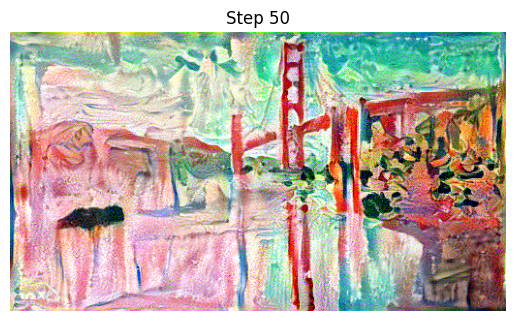

Step 100, Loss: 29.001251220703125


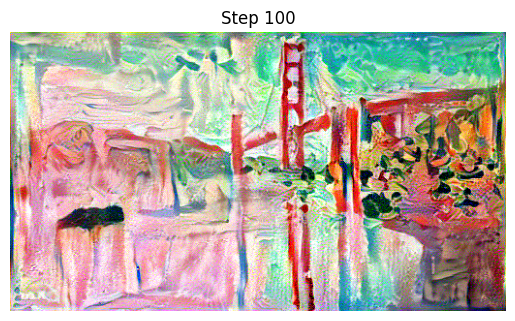

Step 150, Loss: 65.22562408447266


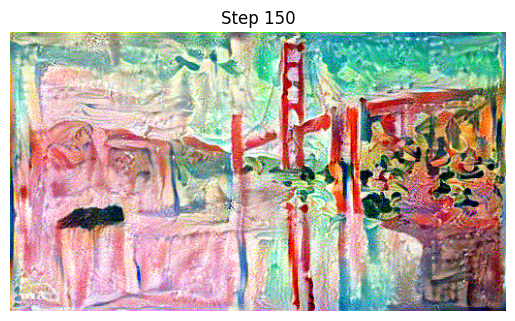

Step 200, Loss: 60.54081726074219


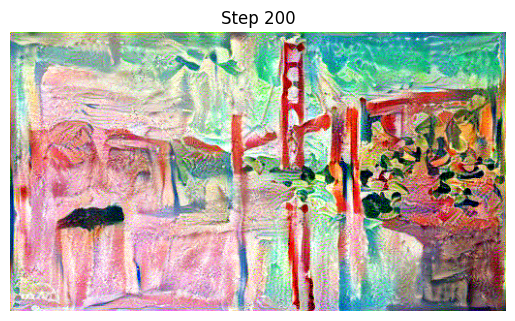

Step 250, Loss: 72.86683654785156


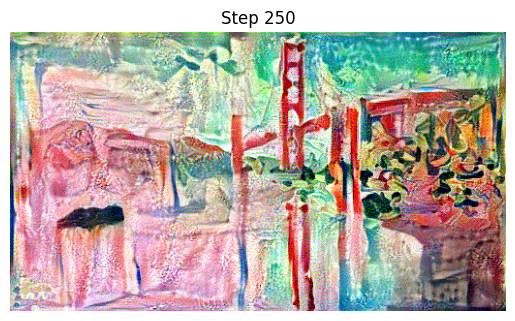

Step 300, Loss: 22.231952667236328


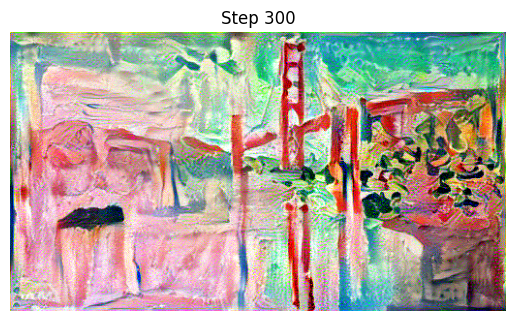

Step 350, Loss: 26.60882568359375


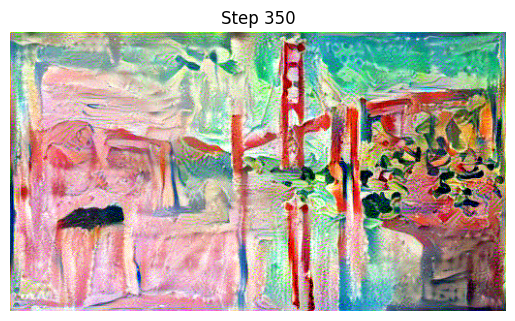

Step 400, Loss: 30.731687545776367


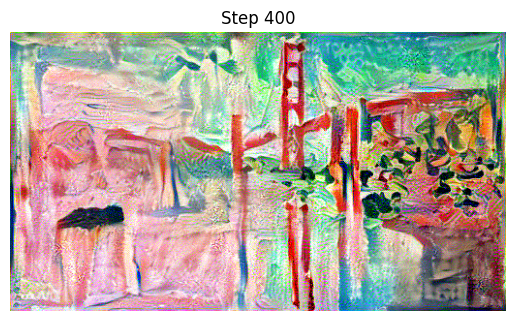

Step 450, Loss: 30.457584381103516


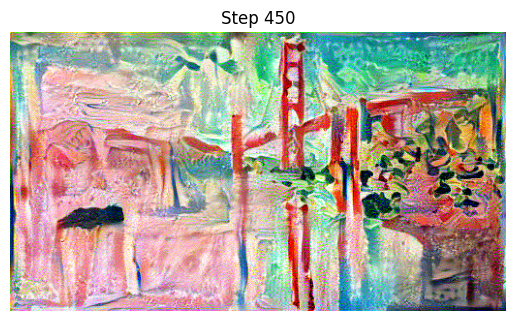

Step 500, Loss: 34.22285842895508


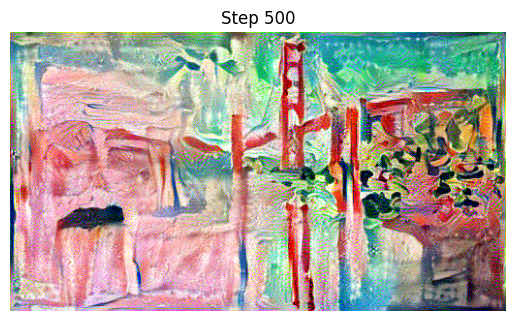

Step 550, Loss: 34.069969177246094


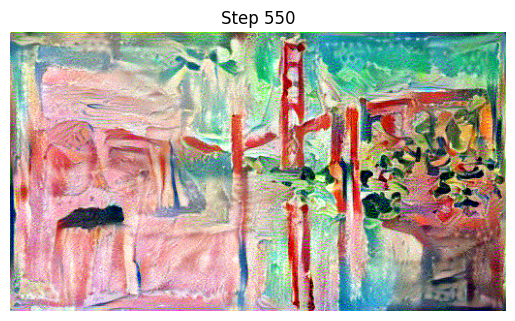

Generated image saved to generated_image.jpg


In [ ]:
# Use LBFGS optimizer: better but so slow
def closure():
    optimizer.zero_grad()

    generated_features = get_features(generated_img, vgg, content_layers + style_layers)

    content_loss = sum(torch.mean((generated_features[layer] - content_features[layer]) ** 2) for layer in content_layers)

    style_loss = sum(torch.mean((gram_matrix(generated_features[layer]) - gram_matrix(style_features[layer])) ** 2)
                     for layer in style_layers)

    total_loss = content_loss + style_loss * style_weight
    total_loss.backward()

    return total_loss

num_steps = 600
for step in range(num_steps):
    optimizer.step(closure)

    if step % 50 == 0:
        print(f"Step {step}, Loss: {closure().item()}")
        with torch.no_grad():
            imshow(generated_img, title=f"Step {step}")

output_path = 'generated_image.jpg'
output_image = transforms.ToPILImage()(generated_img.cpu().squeeze(0).clamp(0, 1))
output_image.save(output_path)
print(f"Generated image saved to {output_path}")
